
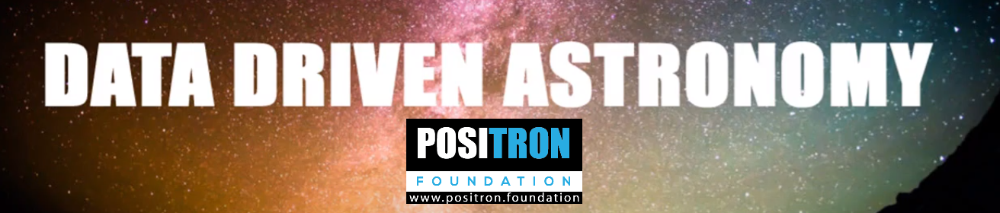




In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Welcome to **IV week** of **Data Driven Astronomy** Online course organized by **Positron Foundation**

This week you will be working in groups. You can use the following notebook for the group activity tasks.

**Setting up packages**

In [ ]:
!pip install sdss-marvin --quiet

     |████████████████████████████████| 393 kB 33.5 MB/s 
     |████████████████████████████████| 50 kB 6.4 MB/s 
     |████████████████████████████████| 284 kB 60.6 MB/s 
     |████████████████████████████████| 55 kB 3.7 MB/s 
     |████████████████████████████████| 54 kB 2.8 MB/s 
     |████████████████████████████████| 50 kB 6.4 MB/s 
     |████████████████████████████████| 49 kB 5.9 MB/s 
     |████████████████████████████████| 525 kB 65.1 MB/s 
     |████████████████████████████████| 636 kB 65.1 MB/s 
     |████████████████████████████████| 169 kB 57.0 MB/s 
     |████████████████████████████████| 100 kB 10.7 MB/s 
     |████████████████████████████████| 41 kB 371 kB/s 
     |████████████████████████████████| 212 kB 56.1 MB/s 
     |████████████████████████████████| 40 kB 5.7 MB/s 
     |████████████████████████████████| 548 kB 63.6 MB/s 
     |████████████████████████████████| 111 kB 68.5 MB/s 
     |████████████████████████████████| 47 kB 4.7 MB/s 
     |████████████████████████

In [ ]:
!git clone https://github.com/Jack3690/DDA

Cloning into 'DDA'...
remote: Enumerating objects: 311, done.
remote: Counting objects: 100% (311/311), done.
remote: Compressing objects: 100% (264/264), done.
remote: Total 311 (delta 151), reused 130 (delta 34), pack-reused 0
Receiving objects: 100% (311/311), 36.90 MiB | 26.04 MiB/s, done.
Resolving deltas: 100% (151/151), done.


In [ ]:
!cp -a DDA/sas /root/

!cp -a DDA/sas/map.py /usr/local/lib/python3.7/dist-packages/marvin/utils/plot/

!mkdir  /root/sas/dr16
!cp -a /root/sas/mangawork/manga/ /root/sas/dr16

In [ ]:
cd DDA/Week_4/data

/content/DDA/Week_4/data


In [ ]:
import numpy as np
import astropy

from astropy.visualization import LogStretch
from astropy.visualization.mpl_normalize import ImageNormalize
import astropy.units as u
from astropy.wcs import WCS
from astropy.io import fits
import astropy.stats as stats
from astropy.cosmology import WMAP9 as cosmo
from astropy.cosmology import Planck15
from astropy.io import fits

from marvin import config
from marvin.tools.cube import Cube
from marvin.tools.maps import Maps
import marvin.utils.plot.map as mapplot 


# To improve Aesthetics of plots

import matplotlib
matplotlib.rcParams['figure.figsize'] = (10,10)
matplotlib.rcParams['font.size'] = 15

/usr/local/lib/python3.7/dist-packages/marvin/core/exceptions.py:51: UserWarning: cannot initiate Sentry error reporting: [Errno 6] No such device or address.
  UserWarning)
[INFO]: No release version set. Setting default to DR15


In [ ]:
# set the release to DR15
config.setRelease("DR15")
config.release

'DR15'

In [ ]:
!pip install sep --quiet
!pip install photutils --quiet
!pip install astroquery --quiet

     |████████████████████████████████| 1.1 MB 30.1 MB/s 
     |████████████████████████████████| 842 kB 30.2 MB/s 
     |████████████████████████████████| 4.4 MB 27.3 MB/s 
     |████████████████████████████████| 802 kB 35.3 MB/s 
     |████████████████████████████████| 54 kB 2.6 MB/s 
     |████████████████████████████████| 3.5 MB 38.7 MB/s 


In [ ]:
import sep
import photutils as phot
from matplotlib import pyplot as plt
from matplotlib.gridspec import GridSpec
from astroquery.skyview import SkyView
from matplotlib import colors

In [ ]:
import gzip
import pandas as pd
import requests
from io import BytesIO as bytesio

In [ ]:
# Downloading gzip file from url

url = "http://gz2hart.s3.amazonaws.com/gz2_hart16.csv.gz"

response = requests.get(url, stream=True)

content = bytesio(response.content)

with gzip.open(content, 'rt') as read_file:
    df = pd.read_csv(read_file)

# **Galaxy Zoo 2**

In [ ]:
df

,dr7objid,ra,dec,rastring,decstring,sample,gz2_class,total_classifications,total_votes,t01_smooth_or_features_a01_smooth_count,t01_smooth_or_features_a01_smooth_weight,t01_smooth_or_features_a01_smooth_fraction,t01_smooth_or_features_a01_smooth_weighted_fraction,t01_smooth_or_features_a01_smooth_debiased,t01_smooth_or_features_a01_smooth_flag,t01_smooth_or_features_a02_features_or_disk_count,t01_smooth_or_features_a02_features_or_disk_weight,t01_smooth_or_features_a02_features_or_disk_fraction,t01_smooth_or_features_a02_features_or_disk_weighted_fraction,t01_smooth_or_features_a02_features_or_disk_debiased,t01_smooth_or_features_a02_features_or_disk_flag,t01_smooth_or_features_a03_star_or_artifact_count,t01_smooth_or_features_a03_star_or_artifact_weight,t01_smooth_or_features_a03_star_or_artifact_fraction,t01_smooth_or_features_a03_star_or_artifact_weighted_fraction,t01_smooth_or_features_a03_star_or_artifact_debiased,t01_smooth_or_features_a03_star_or_artifact_flag,t02_edgeon_a04_yes_count,t02_edgeon_a04_yes_weight,t02_edgeon_a04_yes_fraction,t02_edgeon_a04_yes_weighted_fraction,t02_edgeon_a04_yes_debiased,t02_edgeon_a04_yes_flag,t02_edgeon_a05_no_count,t02_edgeon_a05_no_weight,t02_edgeon_a05_no_fraction,t02_edgeon_a05_no_weighted_fraction,t02_edgeon_a05_no_debiased,t02_edgeon_a05_no_flag,t03_bar_a06_bar_count,...,t10_arms_winding_a30_loose_fraction,t10_arms_winding_a30_loose_weighted_fraction,t10_arms_winding_a30_loose_debiased,t10_arms_winding_a30_loose_flag,t11_arms_number_a31_1_count,t11_arms_number_a31_1_weight,t11_arms_number_a31_1_fraction,t11_arms_number_a31_1_weighted_fraction,t11_arms_number_a31_1_debiased,t11_arms_number_a31_1_flag,t11_arms_number_a32_2_count,t11_arms_number_a32_2_weight,t11_arms_number_a32_2_fraction,t11_arms_number_a32_2_weighted_fraction,t11_arms_number_a32_2_debiased,t11_arms_number_a32_2_flag,t11_arms_number_a33_3_count,t11_arms_number_a33_3_weight,t11_arms_number_a33_3_fraction,t11_arms_number_a33_3_weighted_fraction,t11_arms_number_a33_3_debiased,t11_arms_number_a33_3_flag,t11_arms_number_a34_4_count,t11_arms_number_a34_4_weight,t11_arms_number_a34_4_fraction,t11_arms_number_a34_4_weighted_fraction,t11_arms_number_a34_4_debiased,t11_arms_number_a34_4_flag,t11_arms_number_a36_more_than_4_count,t11_arms_number_a36_more_than_4_weight,t11_arms_number_a36_more_than_4_fraction,t11_arms_number_a36_more_than_4_weighted_fraction,t11_arms_number_a36_more_than_4_debiased,t11_arms_number_a36_more_than_4_flag,t11_arms_number_a37_cant_tell_count,t11_arms_number_a37_cant_tell_weight,t11_arms_number_a37_cant_tell_fraction,t11_arms_number_a37_cant_tell_weighted_fraction,t11_arms_number_a37_cant_tell_debiased,t11_arms_number_a37_cant_tell_flag
0,587732591714893851,179.042984,60.522518,11:56:10.32,+60:31:21.1,original,Sc+t,45,342,0,0.000000,0.000,0.000,0.000,0,42,42.000000,0.933,0.988,0.988,1,3,0.506,0.067,0.012,0.012,0,2,2.0,0.048,0.048,0.047681,0,40,40.000000,0.952,0.952,0.953848,1,1,...,0.025,0.025,0.025,0,0,0.0,0.0,0.0,0.0,0,3,3.0,0.075,0.075,0.075071,0,1,1.0,0.025,0.025,0.024617,0,2,2.0,0.050,0.050,0.049583,0,18,18.000,0.450,0.450,0.482646,0,16,16.0,0.400,0.400,0.394506,0
1,588009368545984617,135.084396,52.494240,09:00:20.26,+52:29:39.3,original,Sb+t,42,332,1,1.000000,0.024,0.024,0.024,0,41,40.205002,0.976,0.976,0.976,1,0,0.000,0.000,0.000,0.000,0,0,0.0,0.000,0.000,0.000000,0,41,40.205002,1.000,1.000,1.000000,1,4,...,0.049,0.050,0.050,0,0,0.0,0.0,0.0,0.0,0,4,4.0,0.098,0.099,0.098063,0,2,2.0,0.049,0.050,0.049983,0,1,1.0,0.024,0.025,0.024977,0,21,20.205,0.512,0.503,0.504833,0,13,13.0,0.317,0.323,0.322743,0
2,587732484359913515,183.371979,50.741508,12:13:29.27,+50:44:29.4,original,Ei,36,125,28,28.000000,0.778,0.780,0.780,0,5,5.000000,0.139,0.139,0.139,0,3,2.892,0.083,0.081,0.081,0,0,0.0,0.000,0.000,0.000000,0,5,5.000000,1.000,1.000,1.000000,1,2,...,0.000,0.000,0.000,0,0,0.0,0.0,0.0,0.0,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,0,0.000,0.000,0.000,0.000000,0,0,0.

In [ ]:
df.describe()

,dr7objid,ra,dec,total_classifications,total_votes,t01_smooth_or_features_a01_smooth_count,t01_smooth_or_features_a01_smooth_weight,t01_smooth_or_features_a01_smooth_fraction,t01_smooth_or_features_a01_smooth_weighted_fraction,t01_smooth_or_features_a01_smooth_debiased,t01_smooth_or_features_a01_smooth_flag,t01_smooth_or_features_a02_features_or_disk_count,t01_smooth_or_features_a02_features_or_disk_weight,t01_smooth_or_features_a02_features_or_disk_fraction,t01_smooth_or_features_a02_features_or_disk_weighted_fraction,t01_smooth_or_features_a02_features_or_disk_debiased,t01_smooth_or_features_a02_features_or_disk_flag,t01_smooth_or_features_a03_star_or_artifact_count,t01_smooth_or_features_a03_star_or_artifact_weight,t01_smooth_or_features_a03_star_or_artifact_fraction,t01_smooth_or_features_a03_star_or_artifact_weighted_fraction,t01_smooth_or_features_a03_star_or_artifact_debiased,t01_smooth_or_features_a03_star_or_artifact_flag,t02_edgeon_a04_yes_count,t02_edgeon_a04_yes_weight,t02_edgeon_a04_yes_fraction,t02_edgeon_a04_yes_weighted_fraction,t02_edgeon_a04_yes_debiased,t02_edgeon_a04_yes_flag,t02_edgeon_a05_no_count,t02_edgeon_a05_no_weight,t02_edgeon_a05_no_fraction,t02_edgeon_a05_no_weighted_fraction,t02_edgeon_a05_no_debiased,t02_edgeon_a05_no_flag,t03_bar_a06_bar_count,t03_bar_a06_bar_weight,t03_bar_a06_bar_fraction,t03_bar_a06_bar_weighted_fraction,t03_bar_a06_bar_debiased,...,t10_arms_winding_a30_loose_fraction,t10_arms_winding_a30_loose_weighted_fraction,t10_arms_winding_a30_loose_debiased,t10_arms_winding_a30_loose_flag,t11_arms_number_a31_1_count,t11_arms_number_a31_1_weight,t11_arms_number_a31_1_fraction,t11_arms_number_a31_1_weighted_fraction,t11_arms_number_a31_1_debiased,t11_arms_number_a31_1_flag,t11_arms_number_a32_2_count,t11_arms_number_a32_2_weight,t11_arms_number_a32_2_fraction,t11_arms_number_a32_2_weighted_fraction,t11_arms_number_a32_2_debiased,t11_arms_number_a32_2_flag,t11_arms_number_a33_3_count,t11_arms_number_a33_3_weight,t11_arms_number_a33_3_fraction,t11_arms_number_a33_3_weighted_fraction,t11_arms_number_a33_3_debiased,t11_arms_number_a33_3_flag,t11_arms_number_a34_4_count,t11_arms_number_a34_4_weight,t11_arms_number_a34_4_fraction,t11_arms_number_a34_4_weighted_fraction,t11_arms_number_a34_4_debiased,t11_arms_number_a34_4_flag,t11_arms_number_a36_more_than_4_count,t11_arms_number_a36_more_than_4_weight,t11_arms_number_a36_more_than_4_fraction,t11_arms_number_a36_more_than_4_weighted_fraction,t11_arms_number_a36_more_than_4_debiased,t11_arms_number_a36_more_than_4_flag,t11_arms_number_a37_cant_tell_count,t11_arms_number_a37_cant_tell_weight,t11_arms_number_a37_cant_tell_fraction,t11_arms_number_a37_cant_tell_weighted_fraction,t11_arms_number_a37_cant_tell_debiased,t11_arms_number_a37_cant_tell_flag
count,2.396950e+05,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239401.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,...,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239689.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239675.000000,239695.0000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.000000,239695.00000,239695.000000,239695.000000
mean,5.878182e+17,185.348053,26.077803,42.569745,179.024565,27.609679,27.483195,0.639344,0.64

Text(0, 0.5, 'DEC (degrees)')

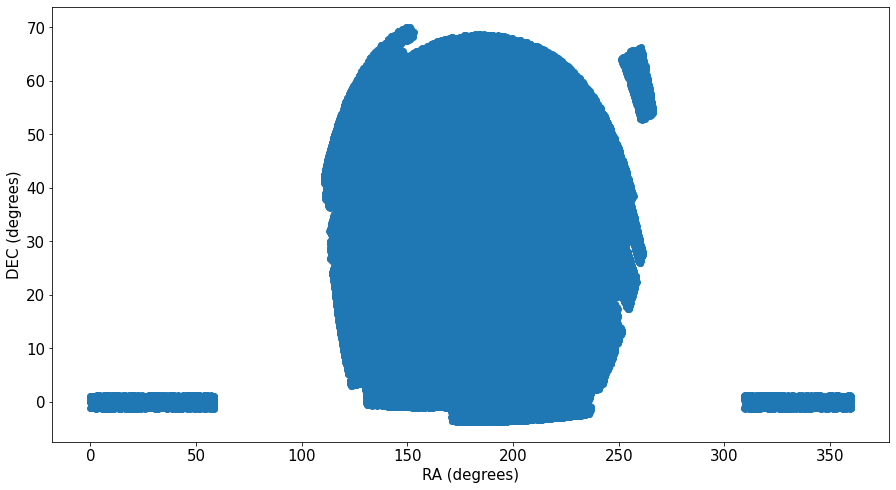

In [ ]:
x = df['ra']
y = df['dec']
plt.figure(figsize = (15,8))
plt.scatter(x,y)
plt.xlabel("RA (degrees)")
plt.ylabel("DEC (degrees)")

In [ ]:
df_cross = pd.read_csv('/content/DDA/Week_4/data/gz2_mangaIFU.csv')

In [ ]:
df_cross

,plateifu,mangaid,dr7objid,ra,dec
0,9512-1901,1-53885,587725075528417524,138.01794,0.421798
1,9512-9101,1-605753,587725075528941624,139.20848,0.572715
2,9512-12705,1-54258,587725075529334954,140.19241,0.604720
3,8713-12704,1-43857,587725469052436738,118.23528,38.928204
4,8713-6104,1-43865,587725469052502129,118.31733,39.050137
...,...,...,...,...,...
3854,8325-12701,1-286558,588298664655061210,210.17632,45.833430
3855,9512-3701,1-53883,588848900431151425,138.06174,0.311792
3856,9512-3704,1-53880,588848900431216934,138.15123,0.309503
3857,9512-6101,1-53897,588848900431544540,138.89056,0.317308


In [ ]:
df_dust = df[(df['t08_odd_feature_a38_dust_lane_debiased']>0.8)]
df_dust

# Classification bias, The overall effect of this bias is a change in observed 
#morphology fractions as a function of redshift independent of any true evolution in galaxy properties.

#Their approach was to bin the galaxies as a function of absolute
#magnitude (M r ), the physical Petrosian half-light radius (R 50 ) and
#redshift. They then computed the average elliptical-to-spiral ratio
#for each (M r , R 50 ) bin in the lowest redshift slice with significant
#numbers of galaxies; this yields a local baseline relation which
#gives the (presumably) unbiased morphology as a function of the
#galaxies’ physical, rather than observed parameters.


,dr7objid,ra,dec,rastring,decstring,sample,gz2_class,total_classifications,total_votes,t01_smooth_or_features_a01_smooth_count,t01_smooth_or_features_a01_smooth_weight,t01_smooth_or_features_a01_smooth_fraction,t01_smooth_or_features_a01_smooth_weighted_fraction,t01_smooth_or_features_a01_smooth_debiased,t01_smooth_or_features_a01_smooth_flag,t01_smooth_or_features_a02_features_or_disk_count,t01_smooth_or_features_a02_features_or_disk_weight,t01_smooth_or_features_a02_features_or_disk_fraction,t01_smooth_or_features_a02_features_or_disk_weighted_fraction,t01_smooth_or_features_a02_features_or_disk_debiased,t01_smooth_or_features_a02_features_or_disk_flag,t01_smooth_or_features_a03_star_or_artifact_count,t01_smooth_or_features_a03_star_or_artifact_weight,t01_smooth_or_features_a03_star_or_artifact_fraction,t01_smooth_or_features_a03_star_or_artifact_weighted_fraction,t01_smooth_or_features_a03_star_or_artifact_debiased,t01_smooth_or_features_a03_star_or_artifact_flag,t02_edgeon_a04_yes_count,t02_edgeon_a04_yes_weight,t02_edgeon_a04_yes_fraction,t02_edgeon_a04_yes_weighted_fraction,t02_edgeon_a04_yes_debiased,t02_edgeon_a04_yes_flag,t02_edgeon_a05_no_count,t02_edgeon_a05_no_weight,t02_edgeon_a05_no_fraction,t02_edgeon_a05_no_weighted_fraction,t02_edgeon_a05_no_debiased,t02_edgeon_a05_no_flag,t03_bar_a06_bar_count,...,t10_arms_winding_a30_loose_fraction,t10_arms_winding_a30_loose_weighted_fraction,t10_arms_winding_a30_loose_debiased,t10_arms_winding_a30_loose_flag,t11_arms_number_a31_1_count,t11_arms_number_a31_1_weight,t11_arms_number_a31_1_fraction,t11_arms_number_a31_1_weighted_fraction,t11_arms_number_a31_1_debiased,t11_arms_number_a31_1_flag,t11_arms_number_a32_2_count,t11_arms_number_a32_2_weight,t11_arms_number_a32_2_fraction,t11_arms_number_a32_2_weighted_fraction,t11_arms_number_a32_2_debiased,t11_arms_number_a32_2_flag,t11_arms_number_a33_3_count,t11_arms_number_a33_3_weight,t11_arms_number_a33_3_fraction,t11_arms_number_a33_3_weighted_fraction,t11_arms_number_a33_3_debiased,t11_arms_number_a33_3_flag,t11_arms_number_a34_4_count,t11_arms_number_a34_4_weight,t11_arms_number_a34_4_fraction,t11_arms_number_a34_4_weighted_fraction,t11_arms_number_a34_4_debiased,t11_arms_number_a34_4_flag,t11_arms_number_a36_more_than_4_count,t11_arms_number_a36_more_than_4_weight,t11_arms_number_a36_more_than_4_fraction,t11_arms_number_a36_more_than_4_weighted_fraction,t11_arms_number_a36_more_than_4_debiased,t11_arms_number_a36_more_than_4_flag,t11_arms_number_a37_cant_tell_count,t11_arms_number_a37_cant_tell_weight,t11_arms_number_a37_cant_tell_fraction,t11_arms_number_a37_cant_tell_weighted_fraction,t11_arms_number_a37_cant_tell_debiased,t11_arms_number_a37_cant_tell_flag
98,587736620399460373,242.808807,26.923412,16:11:14.11,+26:55:24.3,original,Er,40,106,29,29.0,0.725,0.725,0.725,0,2,2.0,0.050,0.050,0.050,0,9,9.000,0.225,0.225,0.225,0,1,1.0,0.500,0.500,0.490121,0,1,1.0,0.500,0.500,0.509173,0,0,...,0.000,0.000,0.000000,0,0,0.0,0.0,0.0,0.0,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0
489,587725576426881085,262.686890,56.351974,17:30:44.85,+56:21:07.1,original,Ec,47,166,32,32.0,0.681,0.694,0.694,0,14,14.0,0.298,0.304,0.304,0,1,0.082,0.021,0.002,0.002,0,9,9.0,0.643,0.643,0.642082,0,5,5.0,0.357,0.357,0.359080,0,0,...,0.000,0.000,0.000000,0,0,0.0,0.0,0.0,0.0,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,0,0.0,0.000,0.000,0.000000,0,1,1.0,1.000,1.000,1.000000,1
661,588017605239439565,236.624954,32.117271,15:46:29.99,+32:07:02.2,original,Sb?t,38,275,2,2.0,0.053,0.054,0.054,0,34,34.0,0.895,0.918,0.918,1,2,1.032,0.053,0.028,0.028,0,1,1.0,0.029,0.029,0.021049,0,33,33.0,0.971,0.971,0.972119,1,1,...,0.031,0.031,0.030151,0,0,0.0,0.0,0.0,0.0,0,6,6.0,0.188,0.188,0.175856,0,2,2.0,0.062,0.062,0.065474,0,1,1.0,0.031,0.031,0.032873,0,1,1.0,0.031,0.031,0.032092,0,22,22.0,0.688,0.688,0.683689,0
771,5877417271121018

##  **Number Density**

In [ ]:
w=np.pi/180
def ang_dist(RA1,DEC1,RA2,DEC2):
  cos_theta = np.sin(DEC1*w) * np.sin(DEC2*w) + np.cos(DEC1*w) * np.cos(DEC2*w) * np.cos(w*(RA2 - RA1))
  return np.arccos(cos_theta)/w  # degrees

n_dens = [] # To store objid of sources
threshold = 5/60 # 5 arcminutes ( Changed from 1)

for i,row1 in df_dust[:1000].iterrows():

  RA1  = row1['ra']
  DEC1 = row1['dec']

  # Initializing
  nn = 0
  # Make RA and DEC cut based on threshold.
  df_temp = df[ (abs(df['ra']-RA1) < threshold) & (abs(df['dec']-DEC1) < threshold) ]

  for j,row2 in df_temp.iterrows():
    if(row1['dr7objid'] != row2['dr7objid']): # For avoiding self reference
      RA2  = row2['ra']
      DEC2 = row2['dec']
      
      # Angular distance
      d = ang_dist(RA1,DEC1,RA2,DEC2)

       # Check if < threshold. If yes make it new min and new nearest neighbour
      if d< threshold:
          nn +=1
  if nn>0:
    n_dens.append([row1['dr7objid'],nn])
# The code will take some time to run

In [ ]:
n_dens = np.array(n_dens)


In [ ]:
plt.hist(n_dens[:,1]);

### **CROSS MATCHING**

In [ ]:
df_search = df_cross[0:0]

for i,row in df_cross.iterrows():
  objid = row['dr7objid']
  if objid in df_dust['dr7objid'].values:
    df_search = df_search.append(row)

df_search

,plateifu,mangaid,dr7objid,ra,dec
106,7990-12702,1-23877,587725505558806667,261.278530,56.878330
174,8719-12701,1-44801,587725552806592794,120.139650,47.509754
192,8626-6103,1-24293,587725576426881085,262.686900,56.351974
351,9182-3702,1-72231,587727866719699087,120.782684,40.226360
404,8143-6101,1-72322,587728669878845816,121.014170,40.802597
459,8717-12702,1-121747,587728932409049377,118.173690,35.320946
613,8978-12701,1-634056,587729653422096493,248.782820,40.991398
644,9869-6101,1-135491,587729751133323512,248.909180,38.972782
786,8439-12704,1-156137,587731500793135266,144.031070,50.439230
795,9193-12705,1-37388,587731511544119382,46.332410,-0.970697


In [ ]:
len(df_search)

47

Text(0, 0.5, 'DEC (degrees)')

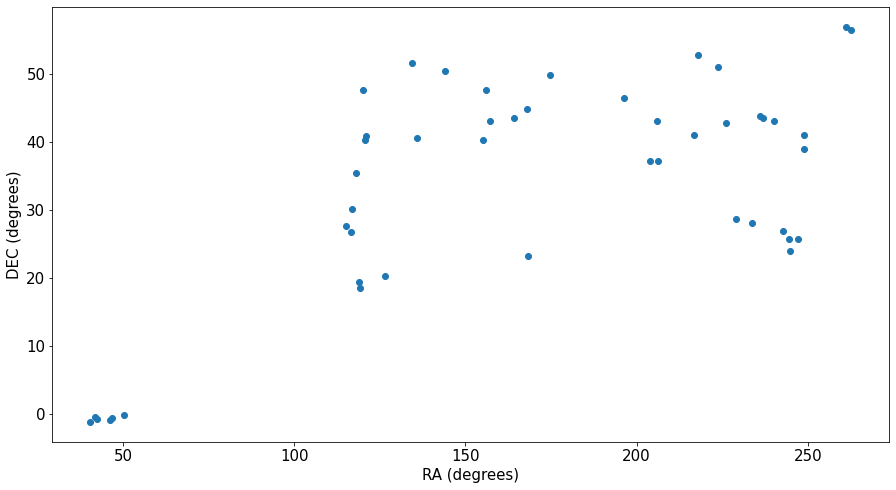

In [ ]:
x = df_search['ra']
y = df_search['dec']
plt.figure(figsize = (15,8))
plt.scatter(x,y)
plt.xlabel("RA (degrees)")
plt.ylabel("DEC (degrees)")

In [ ]:
mkdir'/content/drive/MyDrive/Dust_lanes_rutuja'

mkdir: cannot create directory ‘/content/drive/MyDrive/Dust_lanes_rutuja’: File exists


# **IFU Sample**

[WARNING]: divide by zero encountered in log10 (RuntimeWarning)
[WARNING]: invalid value encountered in multiply (RuntimeWarning)
[WARNING]: invalid value encountered in sqrt (RuntimeWarning)
[WARNING]: divide by zero encountered in log10 (RuntimeWarning)
[WARNING]: invalid value encountered in multiply (RuntimeWarning)
[WARNING]: invalid value encountered in sqrt (RuntimeWarning)
[WARNING]: divide by zero encountered in log10 (RuntimeWarning)
[WARNING]: invalid value encountered in multiply (RuntimeWarning)
[WARNING]: divide by zero encountered in log10 (RuntimeWarning)
[WARNING]: invalid value encountered in multiply (RuntimeWarning)
[WARNING]: invalid value encountered in sqrt (RuntimeWarning)
[WARNING]: divide by zero encountered in log10 (RuntimeWarning)
[WARNING]: divide by zero encountered in log10 (RuntimeWarning)
[WARNING]: invalid value encountered in multiply (RuntimeWarning)
[WARNING]: invalid value encountered in sqrt (RuntimeWarning)
[WARNING]: divide by zero encountered 

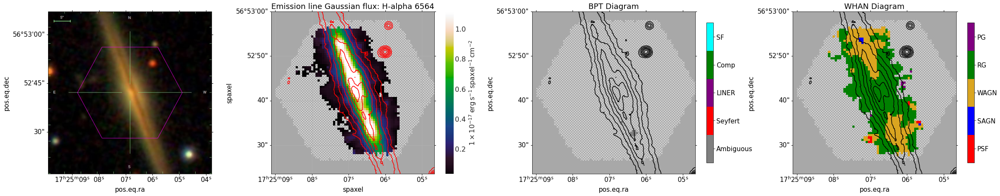

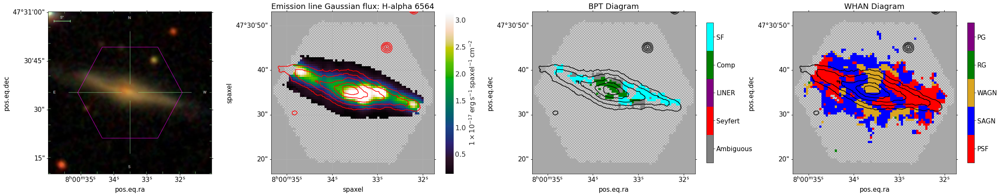

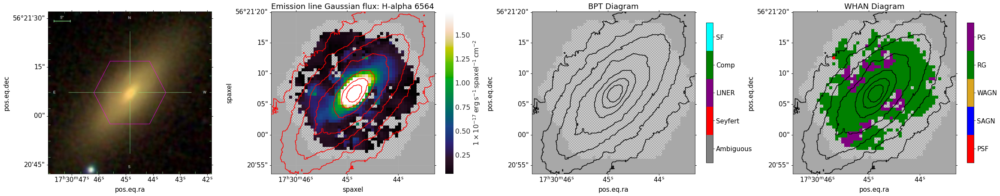

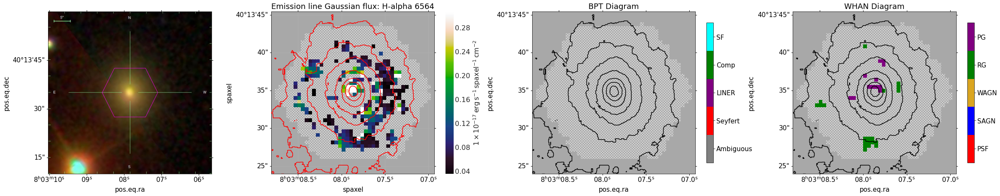

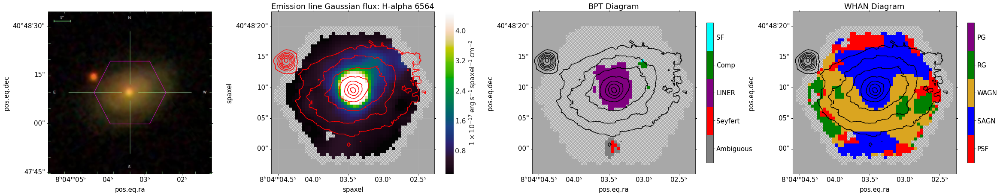

...

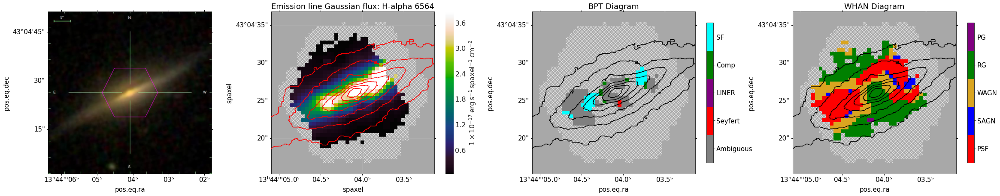

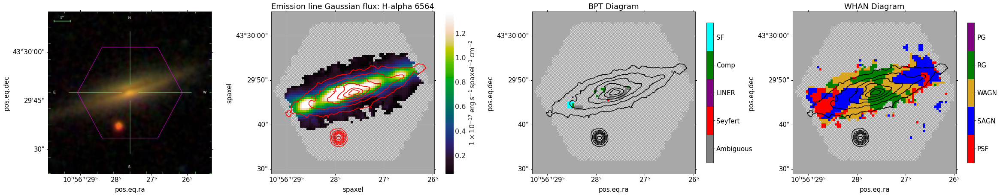

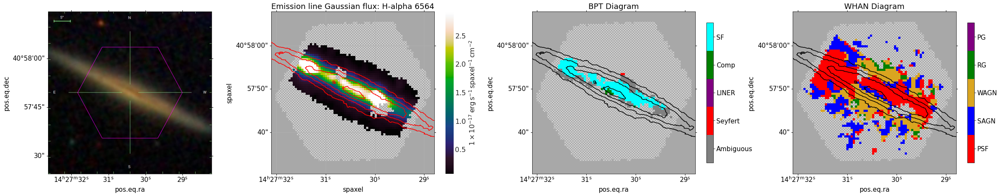

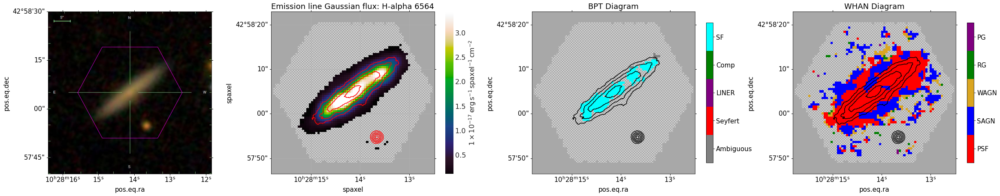

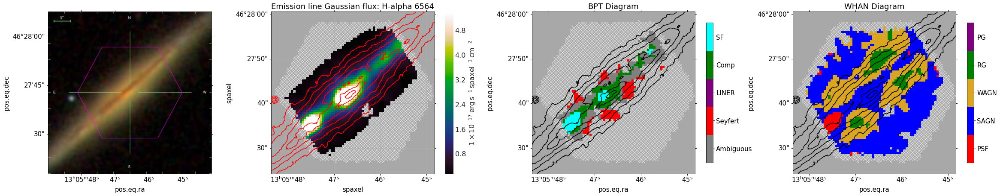

In [ ]:
for plateifu in df_search['plateifu']:
  
  maps = Maps(plateifu=plateifu, mode='remote')

  fig = plt.figure(figsize=(40,7))

  gs = GridSpec(1,4,width_ratios=[0.8,1,1,1])

  # Get wcs of maps

  wcs=maps.wcs

  # Optical image
  optical = maps.getImage()

  ax1 = fig.add_subplot(gs[0,0], projection = optical.wcs) 
  ax1.imshow(optical.data)

  # Get H alpha map

  ha = maps.emline_gflux_ha_6564

  # Set the size of image cutout

  scale = maps.wcs.to_header()['PC2_2']*3600  # Gives arcsec/ pixel

  size = 2*maps.wcs.to_header()['CRPIX1']*scale # Give angular size in arcseconds

  # Getting new cutout

  optical.get_new_cutout(width = size, height = size,scale = size/512)

  filter_r = np.rot90(np.array(optical.data)[:,:,0].T ) 

  ax2 = fig.add_subplot(gs[0,1], projection = maps.wcs, slices=['x','y',0])

  fig,ax2,cb = mapplot.plot(dapmap=ha, fig = fig, ax = ax2, return_cb=True)

  ax2.set_autoscale_on(False)

  # Contour levels
  levels=[60., 90., 120., 150., 180., 210., 240.]

  # Adding contours and transforming it to fit map
  ax2.contour(filter_r, transform = ax2.get_transform(optical.wcs), colors='red',  levels=levels,zorder=11)
  
  # BPT Diagram

  mask, fig_bpt, ax_bpt = maps.get_bpt(show_plot=False)
  # Generate BPT map with WCS projection
  SF = mask['sf']['global'].astype(np.float64)
  COMP = mask ['comp']['global'].astype(np.float64)
  SEYF = mask ['seyfert']['global'].astype(np.float64) 
  LIN = mask ['liner']['global'].astype(np.float64) 
  AMB =  mask ['ambiguous']['global'].astype(np.float64)

  # Giving labels to each class

  SF   *= 5
  COMP *= 4
  SEYF *= 3
  LIN  *= 2
  AMB  *= 1

  # Sum the above masks
  bpt = SF + COMP + SEYF + LIN + AMB

  # Let's make a color map for BPT map

  cmap = colors.ListedColormap(['grey','red', 'purple', 'green', 'cyan'])

  nocov = ha.pixmask.get_mask('NOCOV')

  # Plot

  ax3 = fig.add_subplot(gs[0,2], projection = maps.wcs, slices=['x','y',0])

  # Mapplot plot
  fig, ax3, cb = mapplot.plot(value=bpt, ivar = bpt, mask=nocov, cmap=cmap,fig=fig,ax=ax3, use_masks='NOCOV', return_cb=True, cbrange=(0.5, 5.5), title='BPT Diagram')

  ax3.set_autoscale_on(False)

  # Remove grid
  ax3.grid(False)

  # Plot contours and transform it with optical.wcs and assign the contours black color with levels = levels and zorder =11
  ax3.contour(filter_r, transform=ax3.get_transform(optical.wcs), colors='black',levels=levels,zorder=11)

  # Remove default colorba
  cb.remove()
  # Generate new color bar
  cb = plt.colorbar(ax3.get_images()[1],ax=ax3,anchor=(0,5),shrink=0.86)
  cb.set_ticks([1, 2, 3, 4, 5])
  cb.set_ticklabels(['Ambiguous','Seyfert','LINER','Comp', 'SF'])
  # Set x and y label
  ax3.set_xlabel('pos.eq.ra')
  ax3.set_ylabel('pos.eq.dec')

  # WHAN
  nii =  maps['emline_gflux_nii_6585']                             # Get emline gaussian flux of nii with wavelength 6585
  ha = maps['emline_gflux_ha_6564']                             # Get emline gaussian flux of H alpha  with wavelength 6564
  niiha = nii/ha

  ewha = maps.emline_sew_ha_6564                           # Get emline_sew of H alpha  with wavelength 6564
  ewnii = maps.emline_sew_nii_6585                         # Get emline_sew of nii with wavelength 6585

  # Take the log of the NII/Ha ratio
  logniiha = np.log10(niiha.value)
  psf  = (logniiha < -0.4) & (ewha.value > 3)                       # Pure Star Forming
  sagn = (logniiha > -0.4) & (ewha.value > 6)                       # Strong AGN
  wagn = (logniiha > -0.4) & (ewha.value > 3) &(ewha.value < 6)        # Weak AGN
  rg   = (ewha.value < 3 )                                            # Retired Galaxy  
  pg   = (ewha.value < 0.5) & (ewnii.value < 0.5)                       # Passive Galaxy
  # Create a custom array for a WHAN categories (we copy the EW Ha array just to get a 2d-array of the original size)

  value = ewha.value.copy()
  value[psf]  = 1     # pure star-forming 
  value[sagn] = 2     # strong agn
  value[wagn] = 3     # weak agn
  value[rg]   = 4     # retired galaxies
  value[pg]   = 5     # passive galaxies

  # Set ivar to 0 where the SNR < 1

  niiha_low_snr = mapplot.mask_low_snr(niiha.value, niiha.ivar, snr_min=1)
  ewha_low_snr  = mapplot.mask_low_snr(ewha.value, ewha.ivar, snr_min=1)
  # Complete the code
  ewnii_low_snr = mapplot.mask_low_snr(ewnii.value, ewnii.ivar, snr_min=1)

  low_snr       = np.logical_or(niiha_low_snr, ewha_low_snr, ewnii_low_snr)

  ivar = ewha.value.copy()
  ivar[low_snr] = 0
  value[low_snr] = 6

  # WHAN IFU

  ax4 = fig.add_subplot(gs[0,3],projection=maps.wcs,slices=('x','y',0))
  #  Remove grid
  ax4.grid(False)

  # Create colormap with colors 'red', 'blue', 'goldenrod', 'green', 'purple'
  cmap = colors.ListedColormap(['red', 'blue', 'goldenrod', 'green', 'purple'])

  # Get nocov mask from ewha map

  nocov = ewha.pixmask.get_mask('NOCOV')

  # Mapplot.plot  function call
  fig, ax4, cb = mapplot.plot(value=value, ivar=ivar, mask=nocov, cmap=cmap,fig=fig,ax=ax4, use_masks='NOCOV', return_cb=True, cbrange=(0.5, 5.5), title='WHAN Diagram')

  # Set autoscale to False
  ax4.set_autoscale_on(False)

  # Create contour of filter_r and transform it using optical.wcs. Give color = 'black' and zorder=11
  ax4.contour(filter_r, transform=ax4.get_transform(optical.wcs), colors='black',levels=levels,zorder=11)

  # Remove default colorbar
  cb.remove()

  # Create new color bar
  cb = plt.colorbar(ax4.get_images()[1],ax=ax4,anchor=(0,5),shrink=0.86)

  # Set ticks [1, 2, 3, 4, 5]
  cb.set_ticks([1, 2, 3, 4, 5])

  # Set ticklabels ['PSF', 'SAGN', 'WAGN', 'RG', 'PG']
  cb.set_ticklabels( ['PSF', 'SAGN', 'WAGN', 'RG', 'PG'])

  # Set axes labels
  ax4.set_xlabel('pos.eq.ra')
  ax4.set_ylabel('pos.eq.dec')

  fig.savefig(f'/content/drive/MyDrive/Dust_lanes_rutuja/{plateifu}.png')

In [ ]:
mkdir'/content/drive/MyDrive/run_rutuja'

mkdir: cannot create directory ‘/content/drive/MyDrive/run_rutuja’: File exists


# **RGB Images**

In [ ]:
!pip install astroquery --quiet

In [ ]:
from astroquery.skyview import SkyView

In [ ]:
def norm(data):
  return (data-data.min())/(data.max()-data.min())

Here are Infrared - Optical - Ultraviolet, RAD-RGB images i.e the red channel has IR data (WISE 22), the green channel has data at the Optical visible wavelength (DSS2 R) and the blue channel has UV data (Galex NUV). So, an IOU-RGB image is not a real colour image but multi-wavelength image, one visible and two invisible to human eye.


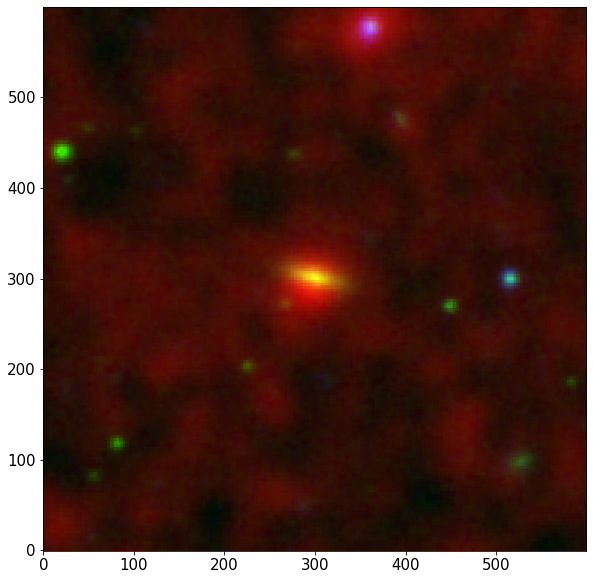

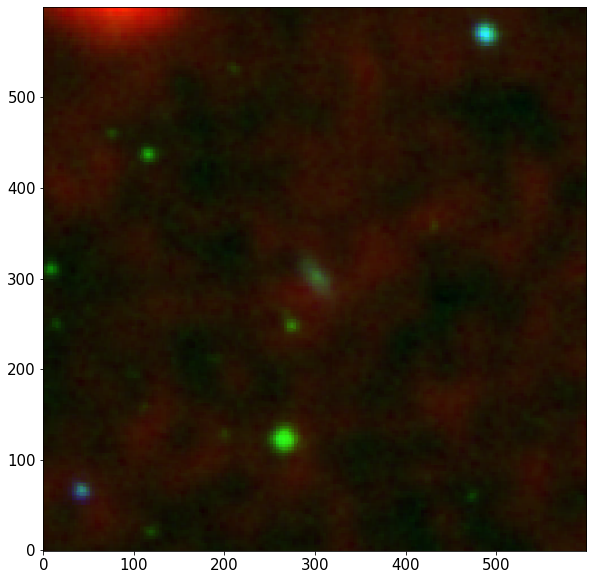

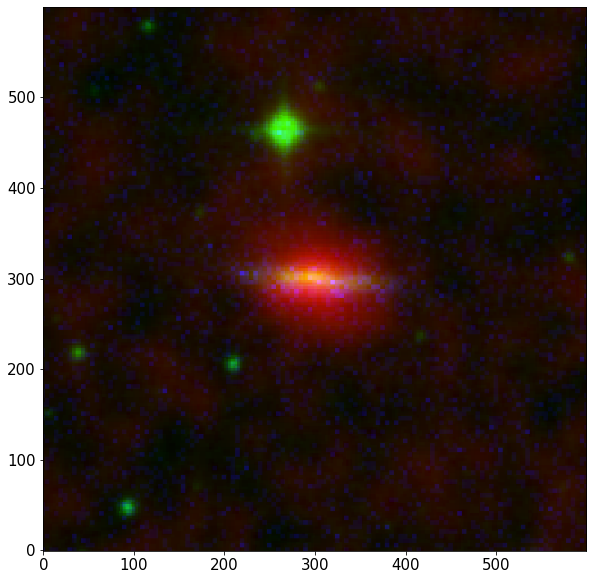

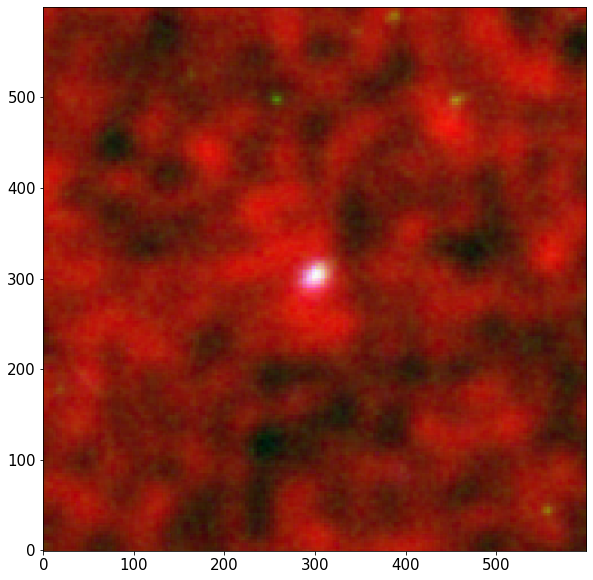

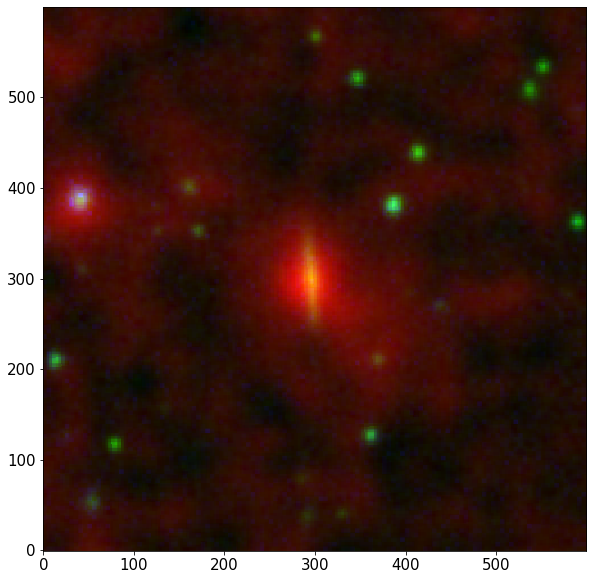

...

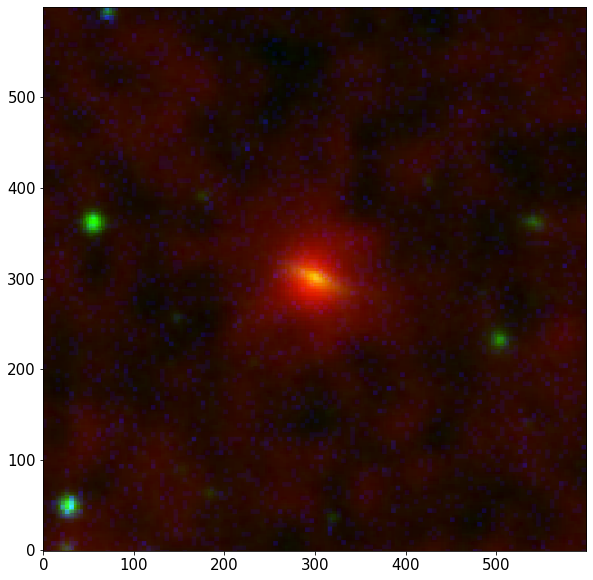

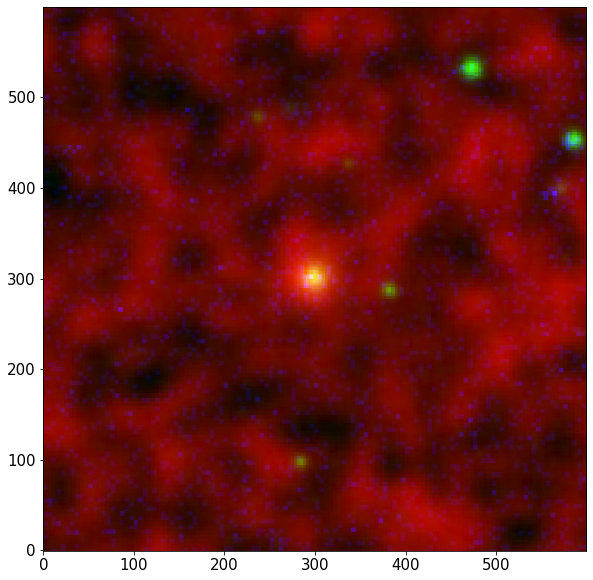

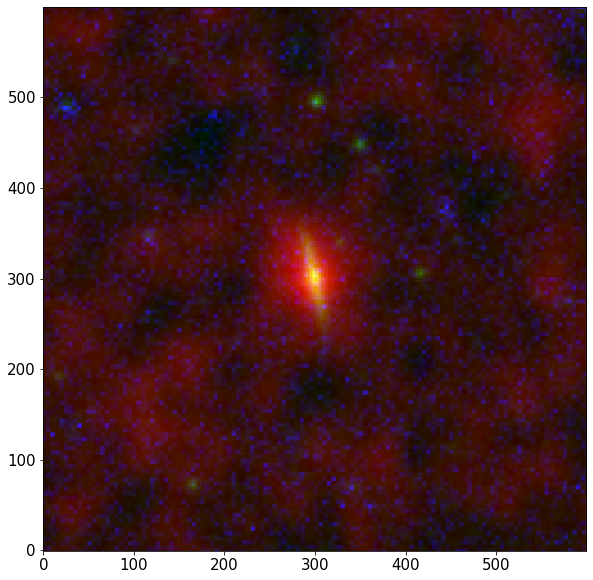

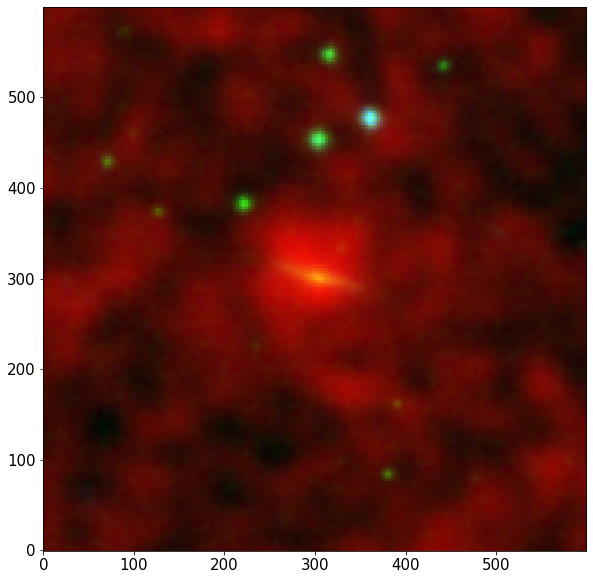

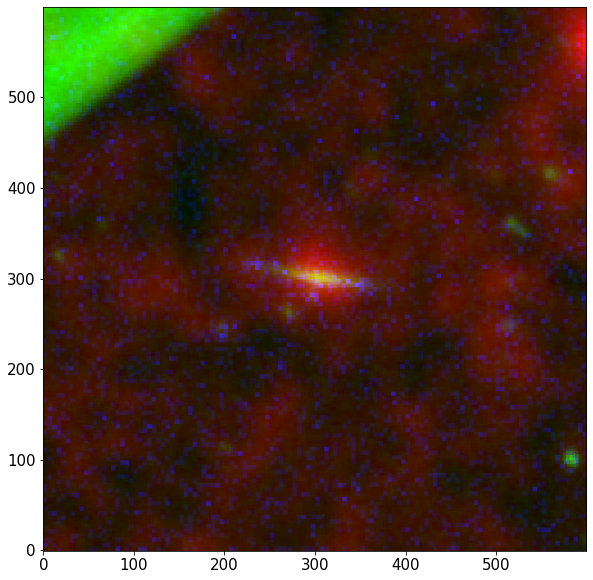

[WARNING]: unclosed <ssl.SSLSocket [closed] fd=82, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6> (ResourceWarning)


Data not found for 8455-12702


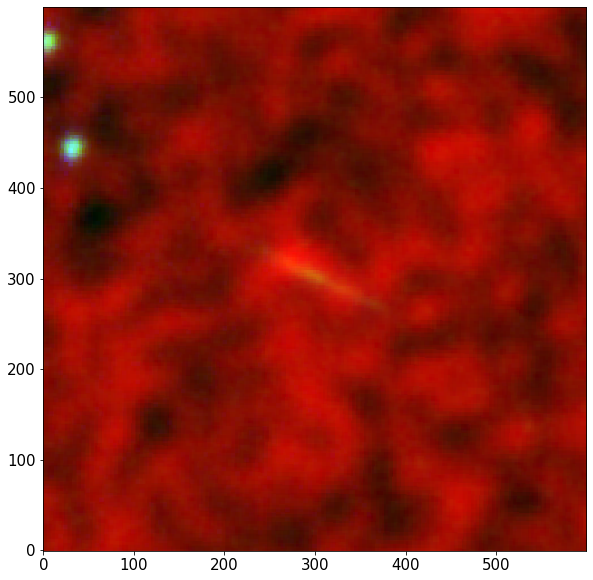

Data not found for 8449-12703


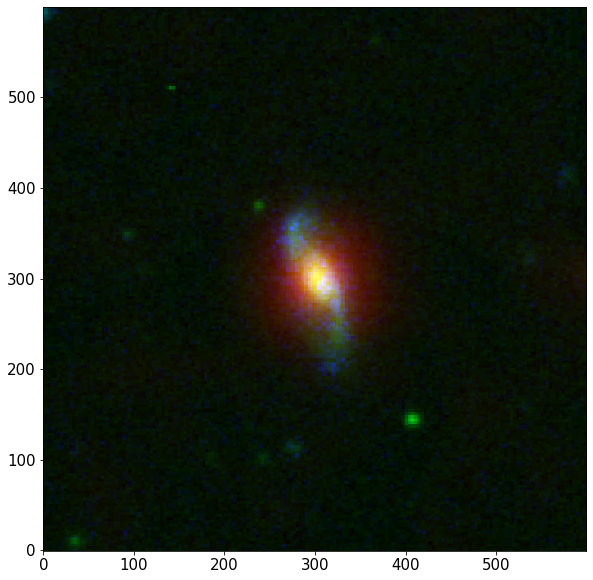

[WARNING]: unclosed <ssl.SSLSocket [closed] fd=82, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6> (ResourceWarning)


Data not found for 8446-12703


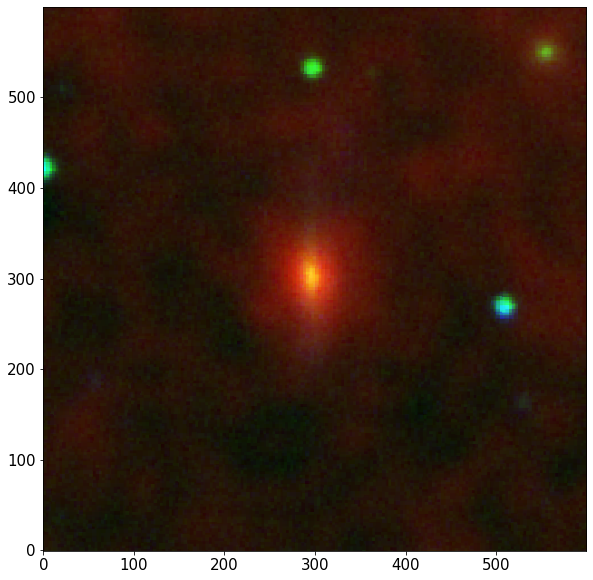

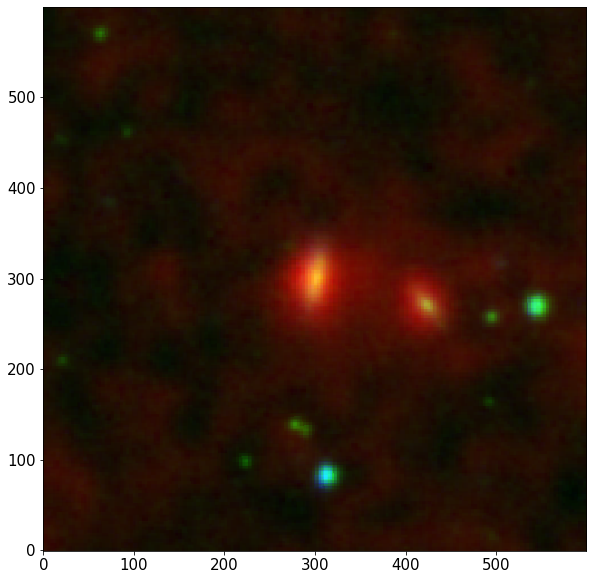

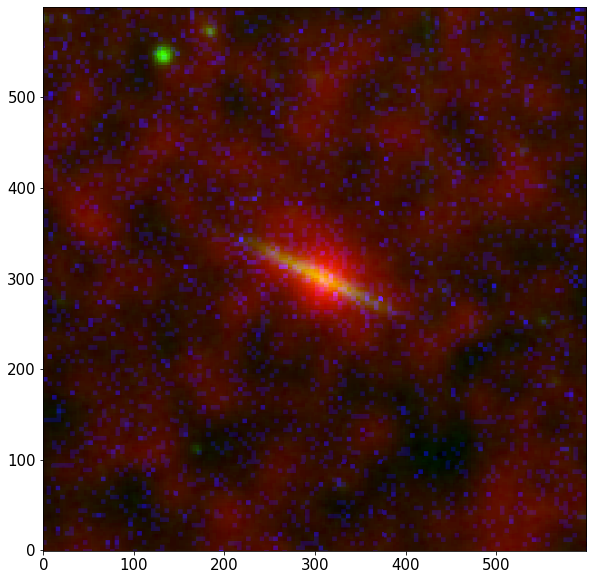

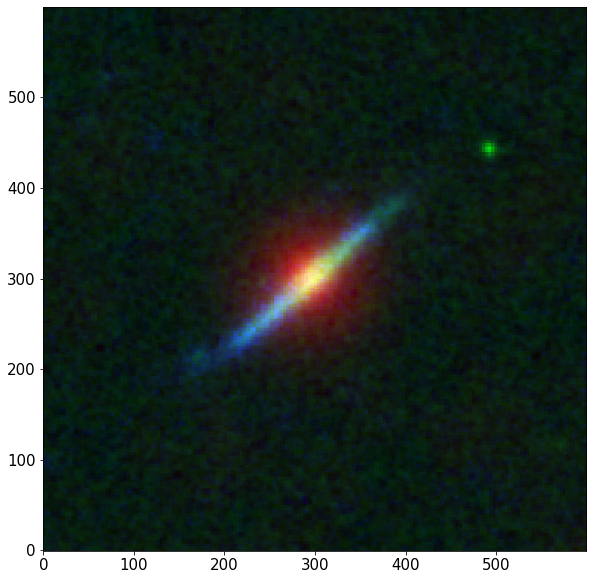

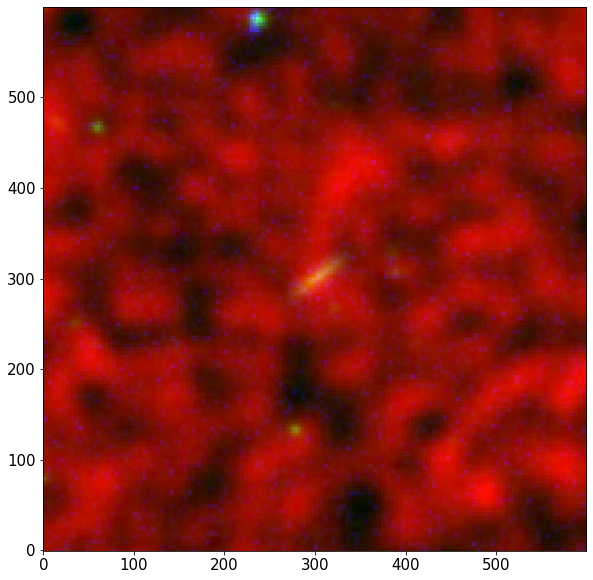

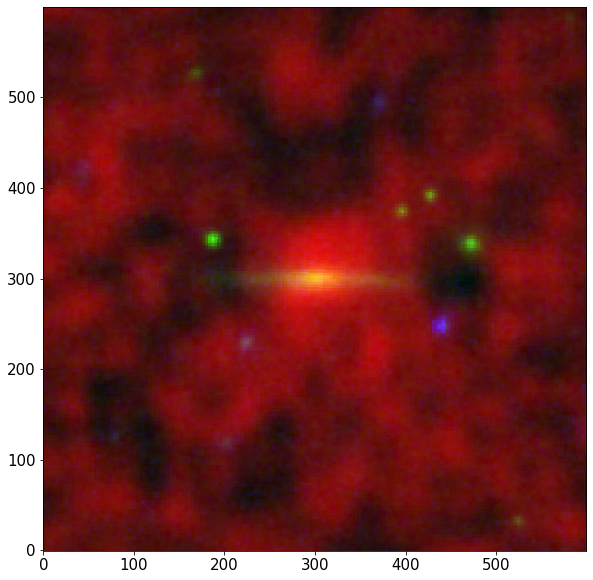

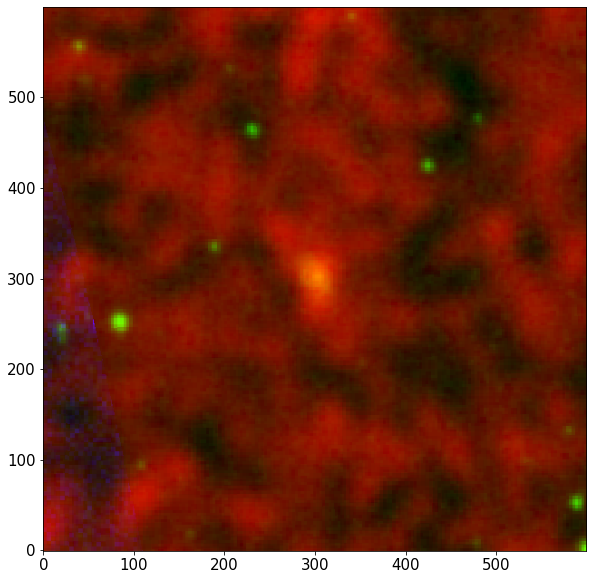

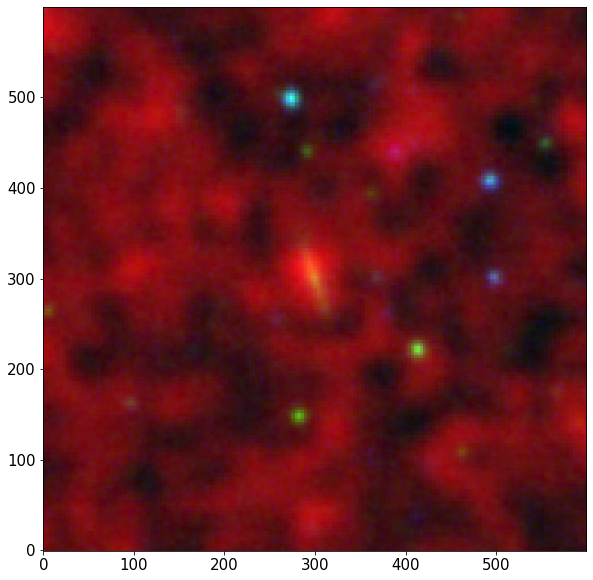

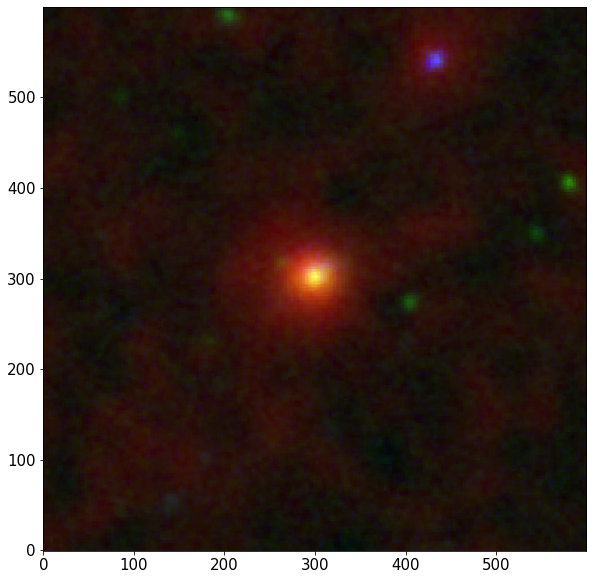

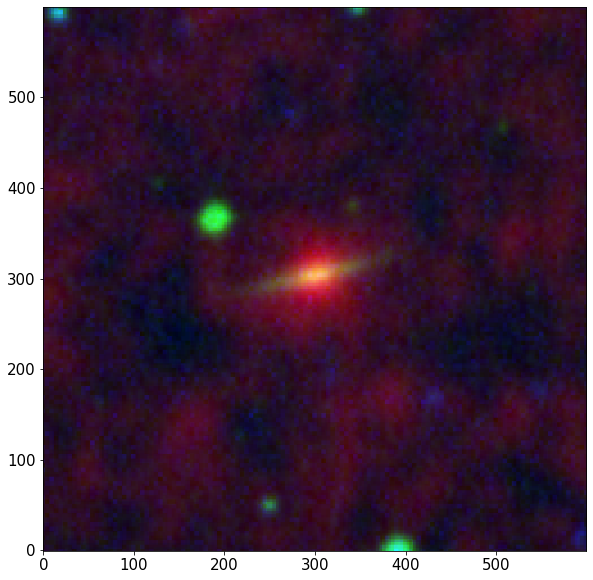

In [ ]:
galaxy=['9869-6101', '9491-9101', '9488-12701','9193-3701' ,'9048-12703' ,'9037-9102' ,'9036-12702', '9035-6101', '8990-12704', '8719-12701' ,'8547-12702' ,'8455-12702','8452-12702' ,'8449-12703', '8446-12704' ,'8446-12703' ,'8440-12705' ,'8439-12704' ,'8335-12703' ,'8318-12702', '8253-12701', '8244-12705' ,'8147-6101' ,'8144-3704', '8143-6101' ,'8081-12703' ]
for i in galaxy:
  try :
    paths = SkyView.get_images(position= 'manga ' + f'{i}',radius=3*u.arcmin,pixels=600,survey=[ 'WISE 22', 'DSS2 Red', 'GALEX Near UV'])
    
    #paths[0][0].header # First object in the list
    R = paths[0][0].data  
    G = paths[1][0].data
    B = paths[2][0].data

    # Use the functions you defined earlier
    R_norm = norm(R)
    G_norm = norm(G) 
    B_norm = norm(B)  

    RGB = np.stack([R_norm,G_norm,B_norm],axis=2)            # Stacked 3D array
    plt.imshow(RGB,origin='lower')
    plt.show()
  except:
    print(f"Data not found for {i}")
  
  #plt.savefig(f'/content/drive/MyDrive/run_rutuja/{i}.png')